<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#하이퍼파라미터-세팅-및-seed-고정" data-toc-modified-id="하이퍼파라미터-세팅-및-seed-고정-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>하이퍼파라미터 세팅 및 seed 고정</a></span></li><li><span><a href="#학습-데이터-EDA" data-toc-modified-id="학습-데이터-EDA-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>학습 데이터 EDA</a></span></li><li><span><a href="#데이터-전처리-함수-정의-(Dataset)" data-toc-modified-id="데이터-전처리-함수-정의-(Dataset)-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>데이터 전처리 함수 정의 (Dataset)</a></span></li><li><span><a href="#Dataset-정의-및-DataLoader-할당" data-toc-modified-id="Dataset-정의-및-DataLoader-할당-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Dataset 정의 및 DataLoader 할당</a></span><ul class="toc-item"><li><span><a href="#데이터-샘플-시각화-(Show-example-image-and-mask)" data-toc-modified-id="데이터-샘플-시각화-(Show-example-image-and-mask)-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>데이터 샘플 시각화 (Show example image and mask)</a></span></li></ul></li><li><span><a href="#baseline-model" data-toc-modified-id="baseline-model-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>baseline model</a></span><ul class="toc-item"><li><span><a href="#FCN8s-(VGG-imageNet-weight)" data-toc-modified-id="FCN8s-(VGG-imageNet-weight)-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>FCN8s (VGG imageNet weight)</a></span></li></ul></li><li><span><a href="#train,-validation,-test-함수-정의" data-toc-modified-id="train,-validation,-test-함수-정의-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>train, validation, test 함수 정의</a></span></li><li><span><a href="#모델-저장-함수-정의" data-toc-modified-id="모델-저장-함수-정의-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>모델 저장 함수 정의</a></span></li><li><span><a href="#모델-생성-및-Loss-function,-Optimizer-정의" data-toc-modified-id="모델-생성-및-Loss-function,-Optimizer-정의-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>모델 생성 및 Loss function, Optimizer 정의</a></span></li><li><span><a href="#저장된-model-불러오기-(학습된-이후)" data-toc-modified-id="저장된-model-불러오기-(학습된-이후)-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>저장된 model 불러오기 (학습된 이후)</a></span></li><li><span><a href="#submission을-위한-test-함수-정의" data-toc-modified-id="submission을-위한-test-함수-정의-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>submission을 위한 test 함수 정의</a></span></li><li><span><a href="#submission.csv-생성" data-toc-modified-id="submission.csv-생성-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>submission.csv 생성</a></span></li><li><span><a href="#Reference" data-toc-modified-id="Reference-12"><span class="toc-item-num">12&nbsp;&nbsp;</span>Reference</a></span></li></ul></div>

In [2]:
import os
import random
import time
import json
import warnings 

warnings.filterwarnings('ignore')

import logging

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

from model import *
from utils import label_accuracy_score

import numpy as np
import pandas as pd

# 전처리를 위한 라이브러리
from pycocotools.coco import COCO
import torchvision
import torchvision.transforms as transforms

import cv2
import albumentations as A
from albumentations.pytorch import ToTensorV2

# 시각화를 위한 라이브러리
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

plt.rcParams['axes.grid'] = False

print('pytorch version: {}'.format(torch.__version__))
print('GPU 사용 가능 여부: {}'.format(torch.cuda.is_available()))

print(torch.cuda.get_device_name(0))
print(torch.cuda.device_count())

device = "cpu"   # GPU 사용 가능 여부에 따라 device 정보 저장

pytorch version: 1.4.0
GPU 사용 가능 여부: True
Tesla V100-PCIE-32GB
1


## 하이퍼파라미터 세팅 및 seed 고정

In [3]:

version = 'v01'
batch_size = 1   # Mini-batch size
num_epochs = 20
learning_rate = 0.0001

In [4]:
# seed 고정
random_seed = 21
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
# torch.cuda.manual_seed_all(random_seed) # if use multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)
random.seed(random_seed)

## 학습 데이터 EDA

In [5]:
%matplotlib inline

dataset_path = '../input/data'
anns_file_path = dataset_path + '/' + 'train.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Number of super categories: 11
Number of categories: 11
Number of annotations: 21116
Number of images: 2617


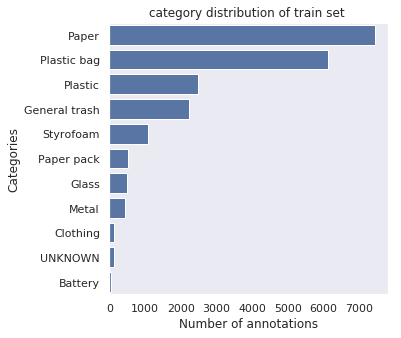

In [6]:
# Count annotations
cat_histogram = np.zeros(nr_cats,dtype=int)
for ann in anns:
    cat_histogram[ann['category_id']] += 1

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,5))

# Convert to DataFrame
df = pd.DataFrame({'Categories': cat_names, 'Number of annotations': cat_histogram})
df = df.sort_values('Number of annotations', 0, False)

# Plot the histogram
plt.title("category distribution of train set ")
plot_1 = sns.barplot(x="Number of annotations", y="Categories", data=df, label="Total", color="b")

In [7]:
# category labeling 
sorted_temp_df = df.sort_index()

# background = 0 에 해당되는 label 추가 후 기존들을 모두 label + 1 로 설정
sorted_df = pd.DataFrame(["Backgroud"], columns = ["Categories"])
sorted_df = sorted_df.append(sorted_temp_df, ignore_index=True)

In [8]:
# class (Categories) 에 따른 index 확인 (0~11 : 총 12개)
sorted_df

,Categories,Number of annotations
0,Backgroud,NaN
1,UNKNOWN,128.0
2,General trash,2225.0
3,Paper,7448.0
4,Paper pack,527.0
5,Metal,449.0
6,Glass,488.0
7,Plastic,2472.0
8,Styrofoam,1074.0
9,Plastic bag,6114.0


## Train Data

In [12]:
train_path = dataset_path + '/train.json'
val_path = dataset_path + '/val.json'
test_path = dataset_path + '/test.json'
all_path = dataset_path + '/train_all.json'

coco_all = COCO(all_path)

loading annotations into memory...
Done (t=5.11s)
creating index...
index created!


In [13]:
x = sorted_df.Categories.values
arr = np.array([])
for i in range(11):
    arr = np.append(arr, len(coco_all.getImgIds(catIds=i)))

len(x)

12

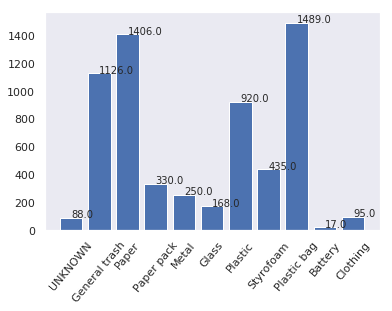

In [86]:
arr
plt.bar(x[1:], arr)
for i, v in enumerate(arr):
    plt.text( i, v+3, str(v))
plt.xticks(rotation='50')
plt.show()

stfkfold

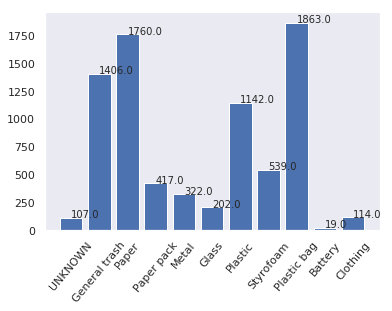

In [17]:
plt.bar(x[1:], arr)
for i, v in enumerate(arr):
    plt.text( i, v+3, str(v))
plt.xticks(rotation='50')
plt.show()

In [22]:
all_ImgIds = set(coco_all.getImgIds())

적은 순서 : 9(배터리)-0(unknown)-10(clothing)-5(glass)-4(metal)-3(paper pack)
6(styrofoam)-7(plastic)-1(general)-2(paper)-8(plastic bag)

# kfold 구현

In [30]:
fold_list = []
n_split = 5
shuffle=False
random_state=None

### unknown

In [29]:
set(coco_all.getImgIds(catIds=0)) & all_ImgIds

107

In [34]:
coco_all.loadImgs(ids=0)[0]

{'license': 0,
 'url': None,
 'file_name': 'batch_01_vt/0002.jpg',
 'height': 512,
 'width': 512,
 'date_captured': None,
 'id': 0}

In [35]:
image_infos = coco_all.loadImgs(ids=0)[0]

In [100]:
dirr = '../input/data/'
for i in coco_train.getImgIds(catIds=9):
    k = coco_train.loadImgs(i)[0]['file_name']
    img = cv2.imread(dirr + k)
    img = cv2.cvtColor(cv2.COLOR_BGR2RGB)
    
    break

In [9]:
dataset.keys() # images : 여기에 filename있음 , categories : 11개 카테고리 있음

dict_keys(['info', 'licenses', 'images', 'categories', 'annotations'])

In [19]:
dataset['annotations']

[{'id': 0,
  'image_id': 0,
  'category_id': 8,
  'segmentation': [[184,
    455,
    183,
    455,
    182,
    455,
    181,
    455,
    181,
    454,
    180,
    454,
    180,
    453,
    179,
    453,
    179,
    452,
    178,
    452,
    178,
    451,
    177,
    451,
    177,
    450,
    176,
    450,
    176,
    449,
    175,
    449,
    175,
    448,
    174,
    448,
    174,
    447,
    173,
    447,
    172,
    447,
    172,
    446,
    171,
    446,
    171,
    445,
    170,
    445,
    170,
    444,
    169,
    444,
    169,
    443,
    168,
    443,
    168,
    442,
    167,
    442,
    167,
    441,
    166,
    441,
    166,
    440,
    166,
    439,
    165,
    439,
    165,
    438,
    164,
    438,
    164,
    437,
    163,
    437,
    163,
    436,
    163,
    435,
    162,
    435,
    162,
    434,
    161,
    434,
    161,
    433,
    160,
    433,
    160,
    432,
    159,
    432,
    158,
    432,
    157,
    432,
    156,
    432,


In [13]:
images = dict()
for n, i in enumerate(dataset['images']):
    images[i['id']] = []

In [16]:
images

{0: [],
 1: [],
 2: [],
 3: [],
 4: [],
 5: [],
 6: [],
 7: [],
 8: [],
 9: [],
 10: [],
 11: [],
 12: [],
 13: [],
 14: [],
 15: [],
 16: [],
 17: [],
 18: [],
 19: [],
 20: [],
 21: [],
 22: [],
 23: [],
 24: [],
 25: [],
 26: [],
 27: [],
 28: [],
 29: [],
 30: [],
 31: [],
 32: [],
 33: [],
 34: [],
 35: [],
 36: [],
 37: [],
 38: [],
 39: [],
 40: [],
 41: [],
 42: [],
 43: [],
 44: [],
 45: [],
 46: [],
 47: [],
 48: [],
 49: [],
 50: [],
 51: [],
 52: [],
 53: [],
 54: [],
 55: [],
 56: [],
 57: [],
 58: [],
 59: [],
 60: [],
 61: [],
 62: [],
 63: [],
 64: [],
 65: [],
 66: [],
 67: [],
 68: [],
 69: [],
 70: [],
 71: [],
 72: [],
 73: [],
 74: [],
 75: [],
 76: [],
 77: [],
 78: [],
 79: [],
 80: [],
 81: [],
 82: [],
 83: [],
 84: [],
 85: [],
 86: [],
 87: [],
 88: [],
 89: [],
 90: [],
 91: [],
 92: [],
 93: [],
 94: [],
 95: [],
 96: [],
 97: [],
 98: [],
 99: [],
 100: [],
 101: [],
 102: [],
 103: [],
 104: [],
 105: [],
 106: [],
 107: [],
 108: [],
 109: [],
 110: [],


## Val Data

## Test Data

## 데이터 전처리 함수 정의 (Dataset)

In [25]:
category_names = list(sorted_df.Categories)

def get_classname(classID, cats):
    for i in range(len(cats)):
        if cats[i]['id']==classID:
            return cats[i]['name']
    return "None"

class CustomDataLoader(Dataset):
    """COCO format"""
    def __init__(self, data_dir, mode = 'train', transform = None):
        super().__init__()
        self.mode = mode
        self.transform = transform
        self.coco = COCO(data_dir)
        
    def __getitem__(self, index: int):
        # dataset이 index되어 list처럼 동작
        image_id = self.coco.getImgIds(imgIds=index)
        image_infos = self.coco.loadImgs(image_id)[0]
        
        # cv2 를 활용하여 image 불러오기
        images = cv2.imread(os.path.join(dataset_path, image_infos['file_name']))
        images = cv2.cvtColor(images, cv2.COLOR_BGR2RGB).astype(np.float32)
        images /= 255.0
        
        if (self.mode in ('train', 'val')):
            ann_ids = self.coco.getAnnIds(imgIds=image_infos['id'])
            anns = self.coco.loadAnns(ann_ids)

            # Load the categories in a variable
            cat_ids = self.coco.getCatIds()
            cats = self.coco.loadCats(cat_ids)

            # masks : size가 (height x width)인 2D
            # 각각의 pixel 값에는 "category id + 1" 할당
            # Background = 0
            masks = np.zeros((image_infos["height"], image_infos["width"]))
            # Unknown = 1, General trash = 2, ... , Cigarette = 11
            for i in range(len(anns)):
                className = get_classname(anns[i]['category_id'], cats)
                pixel_value = category_names.index(className)
                masks = np.maximum(self.coco.annToMask(anns[i])*pixel_value, masks)
            masks = masks.astype(np.float32)

            # transform -> albumentations 라이브러리 활용
            if self.transform is not None:
                transformed = self.transform(image=images, mask=masks)
                images = transformed["image"]
                masks = transformed["mask"]
            
            return images, masks, image_infos
        
        if self.mode == 'test':
            # transform -> albumentations 라이브러리 활용
            if self.transform is not None:
                transformed = self.transform(image=images)
                images = transformed["image"]
            
            return images, image_infos
    
    
    def __len__(self) -> int:
        # 전체 dataset의 size를 return
        return len(self.coco.getImgIds())

## Dataset 정의 및 DataLoader 할당

In [26]:
# train.json / validation.json / test.json 디렉토리 설정
train_path = dataset_path + '/train.json'
val_path = dataset_path + '/val.json'
test_path = dataset_path + '/test.json'

# collate_fn needs for batch
def collate_fn(batch):
    return tuple(zip(*batch))

train_transform = A.Compose([
                            ToTensorV2()
                            ])

val_transform = A.Compose([
                          ToTensorV2()
                          ])

test_transform = A.Compose([
                           ToTensorV2()
                           ])

# create own Dataset 1 (skip)
# validation set을 직접 나누고 싶은 경우
# random_split 사용하여 data set을 8:2 로 분할
# train_size = int(0.8*len(dataset))
# val_size = int(len(dataset)-train_size)
# dataset = CustomDataLoader(data_dir=train_path, mode='train', transform=transform)
# train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# create own Dataset 2
# train dataset
train_dataset = CustomDataLoader(data_dir=train_path, mode='train', transform=train_transform)

# validation dataset
val_dataset = CustomDataLoader(data_dir=val_path, mode='val', transform=val_transform)

# test dataset
test_dataset = CustomDataLoader(data_dir=test_path, mode='test', transform=test_transform)


# DataLoader
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, 
                                           batch_size=batch_size,
                                           shuffle=True,
                                           num_workers=4,
                                           collate_fn=collate_fn)

val_loader = torch.utils.data.DataLoader(dataset=val_dataset, 
                                         batch_size=batch_size,
                                         shuffle=False,
                                         num_workers=4,
                                         collate_fn=collate_fn)

test_loader = torch.utils.data.DataLoader(dataset=test_dataset,
                                          batch_size=batch_size,
                                          num_workers=4,
                                          collate_fn=collate_fn)

loading annotations into memory...
Done (t=3.39s)
creating index...
index created!
loading annotations into memory...
Done (t=0.83s)
creating index...
index created!
loading annotations into memory...
Done (t=1.26s)
creating index...
index created!


### 데이터 샘플 시각화 (Show example image and mask)

- `train_loader` 
- `val_loader` 
- `test_loader` 

In [27]:
len(train_loader)

2617

In [28]:
len(val_loader)

655

In [29]:
len(test_loader)

837

In [30]:
dataset.keys()

dict_keys(['info', 'licenses', 'images', 'categories', 'annotations'])

In [37]:
dataset['annotations']

[{'id': 0,
  'image_id': 0,
  'category_id': 8,
  'segmentation': [[184,
    455,
    183,
    455,
    182,
    455,
    181,
    455,
    181,
    454,
    180,
    454,
    180,
    453,
    179,
    453,
    179,
    452,
    178,
    452,
    178,
    451,
    177,
    451,
    177,
    450,
    176,
    450,
    176,
    449,
    175,
    449,
    175,
    448,
    174,
    448,
    174,
    447,
    173,
    447,
    172,
    447,
    172,
    446,
    171,
    446,
    171,
    445,
    170,
    445,
    170,
    444,
    169,
    444,
    169,
    443,
    168,
    443,
    168,
    442,
    167,
    442,
    167,
    441,
    166,
    441,
    166,
    440,
    166,
    439,
    165,
    439,
    165,
    438,
    164,
    438,
    164,
    437,
    163,
    437,
    163,
    436,
    163,
    435,
    162,
    435,
    162,
    434,
    161,
    434,
    161,
    433,
    160,
    433,
    160,
    432,
    159,
    432,
    158,
    432,
    157,
    432,
    156,
    432,


In [38]:
dictt = {i:[] for i in range(2617)}

In [40]:
dataset['annotations']

[{'id': 0,
  'image_id': 0,
  'category_id': 8,
  'segmentation': [[184,
    455,
    183,
    455,
    182,
    455,
    181,
    455,
    181,
    454,
    180,
    454,
    180,
    453,
    179,
    453,
    179,
    452,
    178,
    452,
    178,
    451,
    177,
    451,
    177,
    450,
    176,
    450,
    176,
    449,
    175,
    449,
    175,
    448,
    174,
    448,
    174,
    447,
    173,
    447,
    172,
    447,
    172,
    446,
    171,
    446,
    171,
    445,
    170,
    445,
    170,
    444,
    169,
    444,
    169,
    443,
    168,
    443,
    168,
    442,
    167,
    442,
    167,
    441,
    166,
    441,
    166,
    440,
    166,
    439,
    165,
    439,
    165,
    438,
    164,
    438,
    164,
    437,
    163,
    437,
    163,
    436,
    163,
    435,
    162,
    435,
    162,
    434,
    161,
    434,
    161,
    433,
    160,
    433,
    160,
    432,
    159,
    432,
    158,
    432,
    157,
    432,
    156,
    432,


In [1]:
# train_loader의 output 결과(image 및 mask) 확인
for imgs, masks, image_infos in train_loader:
    image_infos = image_infos[0]
    temp_images = imgs
    temp_masks = masks
    

    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 12))

    print('image shape:', list(temp_images[0].shape))
    print('mask shape: ', list(temp_masks[0].shape))
    print('Unique values, category of transformed mask : \n', [{int(i),category_names[int(i)]} for i in list(np.unique(temp_masks[0]))])

    ax1.imshow(temp_images[0].permute([1,2,0]))
    ax1.grid(False)
    ax1.set_title("input image : {}".format(image_infos['file_name']), fontsize = 15)

    ax2.imshow(temp_masks[0])
    ax2.grid(False)
    ax2.set_title("masks : {}".format(image_infos['file_name']), fontsize = 15)

    plt.show()

image shape: [3, 512, 512]
mask shape:  [512, 512]
Unique values, category of transformed mask : 
 [{0, 'Backgroud'}, {'Glass', 6}, {'Plastic', 7}, {9, 'Plastic bag'}]


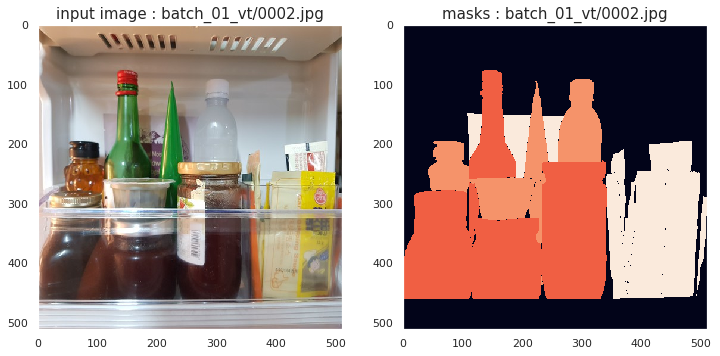

In [14]:
# val_loader의 output 결과(image 및 mask) 확인
for imgs, masks, image_infos in val_loader:
    image_infos = image_infos[0]
    temp_images = imgs
    temp_masks = masks
    
    break

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 12))

print('image shape:', list(temp_images[0].shape))
print('mask shape: ', list(temp_masks[0].shape))

print('Unique values, category of transformed mask : \n', [{int(i),category_names[int(i)]} for i in list(np.unique(temp_masks[0]))])

ax1.imshow(temp_images[0].permute([1,2,0]))
ax1.grid(False)
ax1.set_title("input image : {}".format(image_infos['file_name']), fontsize = 15)

ax2.imshow(temp_masks[0])
ax2.grid(False)
ax2.set_title("masks : {}".format(image_infos['file_name']), fontsize = 15)

plt.show()

image shape: [3, 512, 512]


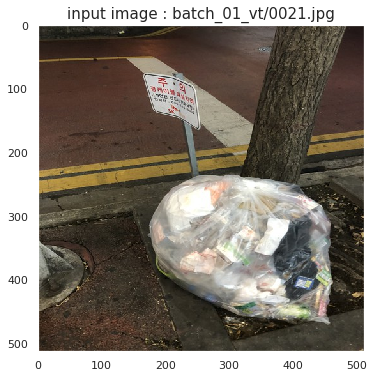

In [15]:
# test_loader의 output 결과(image) 확인
for imgs, image_infos in test_loader:
    image_infos = image_infos[0]
    temp_images = imgs
    
    break

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6, 6))

print('image shape:', list(temp_images[0].shape))

ax1.imshow(temp_images[0].permute([1,2,0]))
ax1.grid(False)
ax1.set_title("input image : {}".format(image_infos['file_name']), fontsize = 15)

plt.show()

In [17]:
# 구현된 model에 임의의 input을 넣어 output이 잘 나오는지 test

model = FCN8s(num_classes=12)
x = torch.randn([1, 3, 512, 512])
print("input shape : ", x.shape)
out = model(x).to(device)
print("output shape : ", out.size())

model = model.to(device)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /opt/ml/.cache/torch/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

input shape :  torch.Size([1, 3, 512, 512])
output shape :  torch.Size([1, 12, 512, 512])
